Links:
* [h3 edges](https://h3geo.org/docs/highlights/aggregation)


## Initial setup

In [1]:
from shapely.geometry import Point, Polygon, GeometryCollection, shape, box
from datetime import datetime
import h3.api.numpy_int as h3
import pandas as pd
import geopandas as gpd
import pyarrow as pa
import numpy as np
import folium
import branca
import geojson
import rout3serv as rrc
import matplotlib


server = rrc.Server(hostport="127.0.0.1:7088")
print(server.version())

for graph_info in server.list_graphs().graphs:
    print(graph_info)
    
graph_handle = rrc.build_graph_handle("germany", 10)

ref_dataset_name = server.list_datasets()[0]
print(f"ref_dataset_name = {ref_dataset_name}")

#graph_h3_resolution = graph_info.h3_resolution

def table_to_geodataframe(table: pa.Table, column_name: str = "h3index") -> gpd.GeoDataFrame:
    df = table.to_pandas()
    return gpd.GeoDataFrame(df,
                            geometry=[Polygon(h3.h3_to_geo_boundary(h, geo_json=True)) for h in
                                      np.nditer(df[column_name].to_numpy())],
                            crs=4326)

def center_of_gdf(gdf: gpd.GeoDataFrame):
    c = box(*gdf.total_bounds).centroid
    return (c.y, c.x)

def style_gdf(gdf: gpd.GeoDataFrame, column_name:str, cmap="viridis"):
    mn = gdf[column_name].min()
    mx = gdf[column_name].max()
    diff = mx-mn
    cmap = matplotlib.cm.get_cmap(cmap)
    
    def style_route(feature):
        value = (float(feature['properties'][column_name]) - mn) / diff
        return { 
            'fillColor' : matplotlib.colors.rgb2hex(cmap(value)),
            'color' : '#888',
            'weight' : 1,
            'fillOpacity' : 0.8,
        }
    return style_route

def style_route(feature):
    if feature['properties'].get('with_disturbance'):
        color = '#f00'
    else: 
        color = "#0f0"
    return { 
        'color' : color,
        'weight' : 2,
    }

version: "0.6.0"
git_commit_sha: "c85e58fdc11b072d0bfe224dfe97765be6239d66"
build_timestamp: "2023-01-23T09:03:16.204980448Z"

name: "germany"
h3_resolution: 11

name: "germany"
h3_resolution: 10

ref_dataset_name = population


# H3 ShortestPath

In [4]:
def calc_some_h3_shortest_path(gh, linestrings=False):

    origins = [
        h3.geo_to_h3(47.687, 9.836, gh.h3_resolution),  # Wangen im Allgäu
        h3.geo_to_h3(49.21299967760608, 8.075637817382812, gh.h3_resolution), # godramstein

    ]
    
    destinations = [
        #h3.geo_to_h3(53.369, 7.206, gh.h3_resolution),  # Emden
        #h3.geo_to_h3(54.315, 13.092, gh.h3_resolution),  # Stralsund
        h3.geo_to_h3(49.183695049773796, 7.895479202270508, gh.h3_resolution), # lug
          
    ]
    
    request = rrc.build_h3_shortest_path_request(
        gh,
        rrc.cell_selection(origins, dataset_name='population'), 
        rrc.cell_selection(destinations, dataset_name='population'),
        routing_mode="prefer-better-roads",
        smoothen_geometries=True
    )
    
    if linestrings:
        return server.h3_shortest_path_linestrings(request)
    return server.h3_shortest_path(request).table.to_pandas()


In [ ]:
%%timeit

sp_df = calc_some_h3_shortest_path(graph_handle)
sp_df["travel_duration_secs"] = pd.to_timedelta(sp_df["travel_duration_secs"], 's')
sp_df

In [6]:
gdf = calc_some_h3_shortest_path(graph_handle, linestrings=True)
gdf["num_coords"] = gdf["geometry"].apply(lambda g: len(g.coords))
gdf

,geometry,h3index_origin,h3index_destination,travel_duration_secs,edge_preference,path_length_m,num_coords
0,"LINESTRING (9.83524 47.68720, 9.83396 47.68736...",622051908237066239,622051291753283583,11516.755859,3.056805,370104.797522,3212
1,"LINESTRING (8.07484 49.21283, 8.07765 49.20680...",622051289158942719,622051291753283583,1071.191772,3.636417,23623.086433,234


In [7]:
m2 = folium.Map(location=center_of_gdf(gdf), zoom_start=8, tiles='OpenStreetMap')

folium.GeoJson(
    gdf,
    style_function=style_route,
    tooltip=folium.features.GeoJsonTooltip([
        "h3index_origin",
        "h3index_destination",
        "travel_duration_secs",
        "edge_preference",
    ])
).add_to(m2)    
    
m2

# WithinThreshold

In [8]:
def calc_upto_some_threshold(gh):
    origins = [
        #h3.geo_to_h3(49.183695049773796, 7.895479202270508, gh.h3_resolution), # lug
        #h3.geo_to_h3(49.21299967760608, 8.075637817382812, gh.h3_resolution), # godramstein    
        h3.geo_to_h3(47.50537402127804, 11.278495788574219, gh.h3_resolution), # krün
        
    ]
    
    request = rrc.build_h3_within_threshold_request(
        gh,
        origins,
        travel_duration_secs_threshold=60*20
    )
    return server.h3_cells_within_threshold(request).table

gdf = table_to_geodataframe(calc_upto_some_threshold(graph_handle), column_name="h3index_cell_origin")
gdf

,h3index_cell_origin,travel_duration_secs,edge_preference,geometry
0,622051453303422975,365.967163,3.019127,"POLYGON ((11.20381 47.49046, 11.20353 47.48981..."
1,622051452413935615,892.161804,3.369218,"POLYGON ((11.09553 47.50057, 11.09526 47.49992..."
2,622051452357607423,968.814270,3.399415,"POLYGON ((11.08219 47.48594, 11.08192 47.48529..."
3,622051453604921343,615.592712,3.647300,"POLYGON ((11.14236 47.48779, 11.14209 47.48714..."
4,622051453441343487,244.369125,4.017917,"POLYGON ((11.28205 47.47523, 11.28178 47.47458..."
...,...,...,...,...
2585,622051497530523647,1009.098206,3.320861,"POLYGON ((11.35534 47.62884, 11.35506 47.62820..."
2586,622051454179737599,1018.148254,3.215740,"POLYGON ((11.10126 47.51420, 11.10099 47.51355..."
2587,622051468128452607,495.726562,3.507428,"POLYGON ((11.25682 47.42616, 11.25654 47.42551..."
2588,622051452358426623,911.604492,3.224191,"POLYGON ((11.08804 47.49130, 11.08777 47.49065..."


In [9]:
m3 = folium.Map(location=center_of_gdf(gdf), zoom_start=11, tiles='OpenStreetMap')

folium.GeoJson(
    gdf,
    style_function=style_gdf(gdf, 'travel_duration_secs'),
    tooltip=folium.features.GeoJsonTooltip([
        "h3index_cell_origin",
        "travel_duration_secs",
    ])
).add_to(m3)    
    
m3

# DifferentialShortestPath

In [10]:
def load_hospitals() -> gpd.GeoDataFrame:
    """test POIs - hospitals. Can be created using the top-level justfile"""
    poi_df = gpd.read_file("../../data/hospital.geojson")
    del poi_df['@id']
    print(f"Using {len(poi_df)} POI locations")

    # only use points
    poi_df["geometry"] = poi_df.geometry.centroid

    # create the h3indexes for the geometries to have them available for the
    # attribution in maps later
    poi_df["h3index"] = poi_df.geometry.map(lambda geom: h3.geo_to_h3(geom.y, geom.x, graph_handle.h3_resolution))

    return poi_df

hospitals_df = load_hospitals()
hospitals_df

Using 5081 POI locations


/tmp/ipykernel_21943/1472163830.py:8: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  poi_df["geometry"] = poi_df.geometry.centroid


,name,amenity,geometry,h3index
0,Kreiskrankenhaus Torgau,hospital,POINT (12.98463 51.56156),622043784436940799
1,Haupteingang Moltkestraße,None,POINT (8.37468 49.01561),622051260145106943
2,Diakonissenkrankenhaus,hospital,POINT (8.40941 48.97196),622051256262852607
3,Stiftungskrankenhaus Nördlingen,hospital,POINT (10.49856 48.83709),622053877832351743
4,Medizinische Klinik,hospital,POINT (11.56182 48.13225),622051814475235327
...,...,...,...,...
5076,Universitätsklinikum Jena,hospital,POINT (11.62072 50.88567),622043917238271999
5077,Universitätsklinikum Jena - Standort Philosoph...,hospital,POINT (11.58151 50.93265),622054004634353663
5078,Universitätsklinikum Jena - Standort Erfurter ...,hospital,POINT (11.56450 50.93451),622054004623278079
5079,Knappschaftskrankenhaus Sulzbach,hospital,POINT (7.05477 49.29778),622053337300795391


## Create a disturbance which hinders traffic

You can use [geojson.io](http://geojson.io) to draw a featurecollection and paste it into the string bellow.

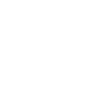

In [11]:
disturbance_geojson_string = """
{
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "properties": {},
      "geometry": {
        "type": "Polygon",
        "coordinates": [
          [
            [
              10.87320327758789,
              47.91300548190604
            ],
            [
              10.876636505126953,
              47.91300548190604
            ],
            [
              10.876636505126953,
              47.91611193960253
            ],
            [
              10.87320327758789,
              47.91611193960253
            ],
            [
              10.87320327758789,
              47.91300548190604
            ]
          ]
        ]
      }
    }
  ]
}
"""


disturbance = GeometryCollection([shape(feature["geometry"]).buffer(0) for feature in geojson.loads(disturbance_geojson_string)["features"]])
disturbance

## Route and Analyze

In [12]:
t_start = datetime.now()
dsp = server.differential_shortest_path(
    rrc.build_differential_shortest_path_request(
        graph_handle,
        disturbance, 
        25000.0, 
        hospitals_df.geometry, 
        ref_dataset_name,
        num_destinations_to_reach=2,
        num_gap_cells_to_graph=3,
        downsampled_prerouting=False
    )
)
print(f"took {datetime.now() - t_start}")
print(f"id: {dsp.id}")

geo_df = table_to_geodataframe(dsp.table, column_name="h3index_origin")
geo_df["travel_duration_increase"] = geo_df["avg_travel_duration_with_disturbance"] - geo_df["avg_travel_duration_without_disturbance"]
geo_df

took 0:00:11.091239
id: 18e72a4e-a122-4130-9e3a-37938d06307c


,h3index_origin,preferred_dest_h3index_without_disturbance,num_reached_without_disturbance,avg_travel_duration_without_disturbance,avg_edge_preference_without_disturbance,preferred_dest_h3index_with_disturbance,num_reached_with_disturbance,avg_travel_duration_with_disturbance,avg_edge_preference_with_disturbance,population,geometry,travel_duration_increase
0,622051486553112575,622051486983454719,2,963.363647,4.290500,622051486983454719,2,963.363647,4.290500,5.835105,"POLYGON ((10.82851 47.86864, 10.82824 47.86800...",0.0
1,622051486553178111,622051486983454719,2,963.363617,4.290086,622051486983454719,2,963.363617,4.290086,7.002126,"POLYGON ((10.82725 47.86779, 10.82698 47.86714...",0.0
2,622051486564319231,622051486983454719,2,963.363708,4.291306,622051486983454719,2,963.363708,4.291306,7.002126,"POLYGON ((10.83355 47.87206, 10.83328 47.87141...",0.0
3,622051486588895231,622051486983454719,2,963.363556,4.253132,622051486983454719,2,963.363556,4.253132,1.053338,"POLYGON ((10.82548 47.84854, 10.82521 47.84789...",0.0
4,622051486589026303,622051486983454719,2,963.363541,4.242779,622051486983454719,2,963.363541,4.242779,2.106676,"POLYGON ((10.83060 47.84784, 10.83033 47.84720...",0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
10457,622051815488913407,622051819860459519,2,1141.867218,5.652423,622051819860459519,2,1141.867218,5.652423,5.325771,"POLYGON ((11.06005 47.98055, 11.05978 47.97990...",0.0
10458,622051815491469311,622051819860459519,2,1181.577759,5.577287,622051819860459519,2,1181.577759,5.577287,5.325771,"POLYGON ((11.05505 47.97303, 11.05478 47.97238...",0.0
10459,622051815492059135,622051819860459519,2,1188.160278,5.681041,622051819860459519,2,1188.160278,5.681041,1.775257,"POLYGON ((11.05378 47.97218, 11.05351 47.97153...",0.0
10460,622051815492288511,622051819860459519,2,1188.160217,5.673257,622051819860459519,2,1188.160217,5.673257,7.101028,"POLYGON ((11.05936 47.97039, 11.05908 47.96974...",0.0


... now map it ...

In [13]:
m = folium.Map(location=center_of_gdf(geo_df), zoom_start=11, tiles='OpenStreetMap')

hospitals_df_subset = hospitals_df.loc[hospitals_df.geometry.within(hospitals_df.dissolve().geometry[0].convex_hull.buffer(0.8))]

folium.GeoJson(
    # use only a subset of the POIs to speed up rendering
    hospitals_df_subset,
    style_function=lambda x: {
        'fillColor': "#c00", 
        'color' : '#800',
        'weight' : 1,
        'fillOpacity' : 0.3,
    },
    tooltip=folium.features.GeoJsonTooltip([
        "name",
        "h3index",
    ])
    ).add_to(m) 

folium.GeoJson(
    disturbance,
    style_function=lambda x: {
        'fillColor': "#c00", 
        'color' : '#800',
        'weight' : 1,
        'fillOpacity' : 0.3,
    },
    ).add_to(m)    
    

colorscale_cell_worsen = branca.colormap.LinearColormap(
    ((1.,1.,1.), (0.0,0.0,1.0)), 
    vmin=0.0, 
    vmax=geo_df['travel_duration_increase'].max()
) 
   
def style_cell(feature):
    cost_inc = feature['properties']['travel_duration_increase'] 
    if cost_inc is None:
        fill = '#f00' # no route found
    else: 
        fill = colorscale_cell_worsen(cost_inc)
    return {
        'fillColor': fill, 
        'color' : '#555',
        'weight' : 1,
        'fillOpacity' : 0.8,
    }

folium.GeoJson(
    geo_df,
    style_function=style_cell,
    tooltip=folium.features.GeoJsonTooltip([
        "h3index_origin",
        "avg_travel_duration_without_disturbance",
        "avg_travel_duration_with_disturbance",
        "travel_duration_increase",
        #"population_origin", 
        "preferred_dest_h3index_without_disturbance", 
        "preferred_dest_h3index_with_disturbance",
        "num_reached_without_disturbance",
        "num_reached_with_disturbance",
        "avg_edge_preference_without_disturbance",
        "avg_edge_preference_with_disturbance",
    ])
    ).add_to(m)    
    
m

In [14]:
some_cells = list(geo_df.sort_values(["travel_duration_increase"], ascending=False).h3index_origin)[:2]

route_gdf = server.get_differential_shortest_path_routes(dsp.id, some_cells, smoothen_geometries=True)
len(route_gdf)
route_gdf

,geometry,h3index_origin,h3index_destination,travel_duration_secs,edge_preference,with_disturbance
0,"LINESTRING (10.87566 47.91213, 10.87689 47.909...",622051487238488063,622051486983454719,526.169556,3.509586,1
1,"LINESTRING (10.87566 47.91213, 10.87689 47.909...",622051487238488063,622051739338506239,1227.281860,5.224582,1
2,"LINESTRING (10.87566 47.91213, 10.87689 47.909...",622051487238488063,622051486983454719,526.169556,3.509586,0
3,"LINESTRING (10.87566 47.91213, 10.87132 47.922...",622051487238488063,622051739338506239,775.600952,3.306666,0
4,"LINESTRING (10.87871 47.90864, 10.87993 47.905...",622051487237668863,622051486983454719,507.055573,3.528796,1
5,"LINESTRING (10.87871 47.90864, 10.87993 47.905...",622051487237668863,622051739338506239,1208.167969,5.259776,1
6,"LINESTRING (10.87871 47.90864, 10.87993 47.905...",622051487237668863,622051486983454719,507.055573,3.528796,0
7,"LINESTRING (10.87871 47.90864, 10.87743 47.908...",622051487237668863,622051739338506239,794.714905,3.299290,0


In [15]:
folium.GeoJson(
    route_gdf, #[route_gdf['with_disturbance'] == 0],
    style_function=style_route,
    tooltip=folium.features.GeoJsonTooltip([
        "h3index_origin",
        "h3index_destination",
        "travel_duration_secs",
        "edge_preference",
    ])
    ).add_to(m)    
    
m

## Retrieve results again using the ID

In [ ]:
dsp2 = server.get_differential_shortest_path(dsp.id)
dsp2.table